# Data access

All datasets stored on ARC3 will be stored in `/nobackup/earlcd/dyamond-conv-org/data` with data for the `DYAMOND Winter` stored in `/nobackup/earlcd/dyamond-conv-org/data/DYAMOND_WINTER`. 

In [71]:
!ls /nobackup/earlcd/dyamond-conv-org/data/DYAMOND_WINTER/

0.10x0.10deg_W-63.00E-33.00S9.00N19.00	native_grid_W-55.00E-25.00S10.00N20.00
goes16


This directory will contain different crops and different resolutions as I create more. For now you see data files at $0.10^{\circ}$ resolution a domain spanning [E,W,S,N] = [-55,-25,0,10] in the tropical Atlantic.

Inside this folder the files are stored in the folder structure with the naming convention adopted by the DYAMOND (for example `DYAMOND_WINTER/MPI-M/ICON-5km/DW-CPL/atmos/15min/rlut/dpp0029/ml/gn/rlut_15min_ICON-5km_DW-CPL_dpp0029_ml_gn_20200120000000-20200120234500.nc`).

You can use the function `make_path` that I've created in the `dyamond.data` module to create these paths (passing to the function which variable, date, resolution, etc you want):

In [2]:
import dyamond.data
import datetime

In [56]:
f_path = dyamond.data.make_path(
    date=datetime.date(year=2020, month=1, day=30),
    variable="rlut",
    model="ICON-5km",
    time_resolution="15min",
    data_root="/nobackup/earlcd/dyamond-conv-org/data/DYAMOND_WINTER/0.10x0.10deg_W-63.00E-33.00S9.00N19.00"
)
f_path

PosixPath('/nobackup/earlcd/dyamond-conv-org/data/DYAMOND_WINTER/0.10x0.10deg_W-63.00E-33.00S9.00N19.00/MPI-M/ICON-5km/DW-CPL/atmos/15min/rlut/dpp0029/ml/gn/rlut_15min_ICON-5km_DW-CPL_dpp0029_ml_gn_20200130000000-20200130234500.nc')

In [57]:
f_path.exists()

True

## Opening a file and plotting the content on a map

In [58]:
import xarray as xr
import cartopy.crs as ccrs
import matplotlib.pyplot as plt

%matplotlib inline

In [59]:
ds = xr.open_dataset(f_path)
ds

<xarray.Dataset>
Dimensions:  (lat: 100, lon: 300, time: 96)
Coordinates:
  * time     (time) datetime64[ns] 2020-01-30 ... 2020-01-30T23:45:00
  * lon      (lon) float64 -62.95 -62.85 -62.75 -62.65 ... -33.25 -33.15 -33.05
  * lat      (lat) float64 9.05 9.15 9.25 9.35 9.45 ... 18.65 18.75 18.85 18.95
Data variables:
    rlut     (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.10 (https://mpimet.mpg.d...
    source:       git@gitlab.dkrz.de:icon/icon-aes.git@432d202fb95b6da024604d...
    institution:  Max Planck Institute for Meteorology
    Conventions:  CF-1.6
    title:        ICON simulation
    history:      Fri Jul 09 15:04:59 2021: cdo -r -v -f nc4 -sellonlatbox,-6...
    references:   see MPIM/DWD publications
    comment:      Sapphire Dyamond (k203123) on m21097 (Linux 2.6.32-754.33.1...
    CDO:          Climate Data Operators version 1.9.10 (https://mpimet.mpg.d...

In [60]:
ds.rlut

<xarray.DataArray 'rlut' (time: 96, lat: 100, lon: 300)>
[2880000 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2020-01-30 ... 2020-01-30T23:45:00
  * lon      (lon) float64 -62.95 -62.85 -62.75 -62.65 ... -33.25 -33.15 -33.05
  * lat      (lat) float64 9.05 9.15 9.25 9.35 9.45 ... 18.65 18.75 18.85 18.95
Attributes:
    standard_name:  toa_outgoing_longwave_flux
    long_name:      toa outgoing longwave radiation
    units:          W m-2
    param:          4.5.0

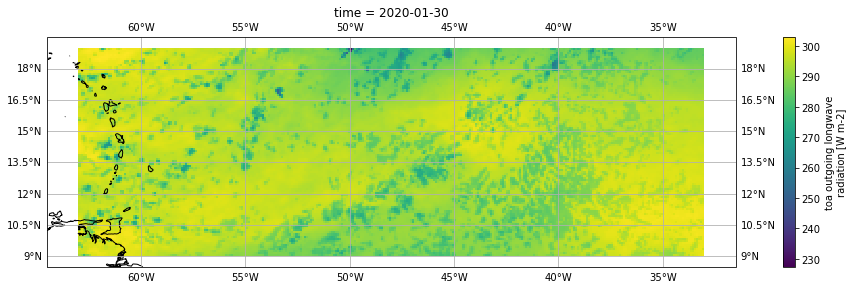

In [61]:
fig, ax = plt.subplots(subplot_kw=dict(projection=ccrs.PlateCarree()), figsize=(14, 4))


ds.isel(time=0).rlut.plot(ax=ax, transform=ccrs.PlateCarree(), rasterized=True)

ax.coastlines(resolution="10m")
ax.gridlines(draw_labels=True)

fig.tight_layout()

# Comparing models

Let's compare the same time in the UM-5km and ICON-5km models. We'll make function to get the datafiles easily

In [68]:
def get_dataset(model="ICON-5km", variable="rlut"):
    f_path = dyamond.data.make_path(
        date=datetime.date(year=2020, month=1, day=20),
        variable=variable,
        model=model,
        time_resolution="15min",
        data_root="/nobackup/earlcd/dyamond-conv-org/data/DYAMOND_WINTER/0.10x0.10deg_W-63.00E-33.00S9.00N19.00"
    )
    ds = xr.open_dataset(f_path)
    da = ds[variable]
    da['model'] = model
    return da

da_lw_um = get_dataset(model="UM-5km")
da_lw_icon = get_dataset(model="ICON-5km")

In [69]:
# although the UM data is meant to be at 15min resolution it appears to only be 2-hourly
# half an hour past the hour. 14:30 (mid-day in the Atlantic) so that the sun is overhead

t0 = "2020-01-20T14:30"

da_lw = xr.concat([da_lw_um, da_lw_icon], dim="model")
da_lw_singletime = da_lw.sel(time=t0)
da_lw_singletime

<xarray.DataArray 'rlut' (model: 2, lat: 100, lon: 300)>
array([[[282.40555, 288.85938, 294.323  , ..., 289.5845 , 288.07574,
         285.1076 ],
        [283.21896, 282.0216 , 283.9332 , ..., 290.24814, 290.02655,
         290.09296],
        [287.31873, 280.66068, 278.33908, ..., 291.45105, 291.51068,
         291.5912 ],
        ...,
        [290.8862 , 291.39355, 292.7103 , ..., 291.83066, 294.39832,
         294.71005],
        [292.2411 , 291.92783, 293.32333, ..., 286.54205, 288.70197,
         292.32266],
        [292.60083, 292.93884, 293.05334, ..., 286.89166, 284.36713,
         284.68887]],

       [[278.59674, 277.83038, 274.53635, ..., 285.76935, 283.28726,
         287.00037],
        [244.55875, 260.58334, 274.597  , ..., 286.88583, 284.33878,
         286.86334],
        [242.9584 , 262.8214 , 280.8398 , ..., 280.49866, 285.3451 ,
         285.34668],
        ...,
        [289.09012, 294.53067, 295.4605 , ..., 287.98303, 291.67316,
         281.28415],
        [288.6431 , 295.67197, 296.1776 , ..., 293.589  , 294.085  ,
         289.40668],
        [291.19574, 296.2074 , 296.4153 , ..., 288.31473, 293.74817,
         295.64618]]], dtype=float32)
Coordinates:
    time     datetime64[ns] 2020-01-20T14:30:00
  * lon      (lon) float64 -62.95 -62.85 -62.75 -62.65 ... -33.25 -33.15 -33.05
  * lat      (lat) float64 9.05 9.15 9.25 9.35 9.45 ... 18.65 18.75 18.85 18.95
  * model    (model) <U8 'UM-5km' 'ICON-5km'
Attributes:
    standard_name:  toa_outgoing_longwave_flux
    long_name:      OUTGOING LW RAD FLUX (TOA)
    units:          W m-2
    cell_methods:   time: mean (interval: 1 hour)
    origin:         toa_outgoing_longwave_flux

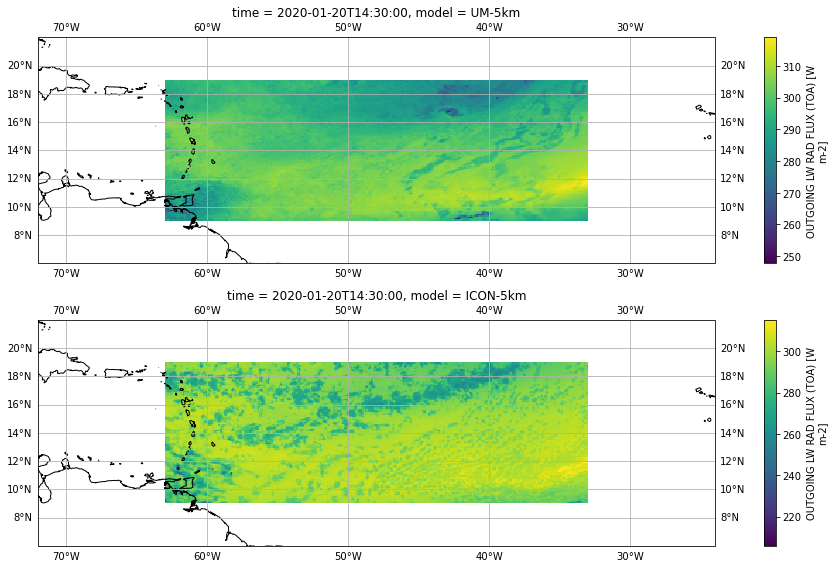

In [70]:
fig, axes = plt.subplots(nrows=2, subplot_kw=dict(projection=ccrs.PlateCarree()), figsize=(14, 8))

for ax, model in zip(axes, da_lw_singletime.model.values):
    da_lw_singletime.sel(model=model).plot(ax=ax, transform=ccrs.PlateCarree(), rasterized=True)

    ax.coastlines(resolution="10m")
    ax.gridlines(draw_labels=True)
    ax.margins(0.3)

fig.tight_layout()


Let's see what the GOES-16 satellite saw at this same time (I will add more images like this, reprojected to lat/lon grid)

In [78]:
from PIL import Image
Image.open("data/DYAMOND_WINTER/images/goes16__202001201430__150dpi.png")